In [572]:
from mothernet.evaluation.fit_learning_curve import ExponentialRegression, plot_exponential_regression, plot_exponential_smoothing, plot_experiment, get_runs
import os
import mlflow
import pandas as pd
from mlflow import MlflowClient
from mlflow.entities import ViewType



mlflow_host =  "20.15.115.222"
mlflow.set_tracking_uri(f"http://{mlflow_host}:5000")

def plot_run_validation(run_name, min_std=0.01, logx=True, return_data=False, norm=True, extra_smoothing=100):
    runs = MlflowClient().search_runs(experiment_ids=0, filter_string=f"attributes.run_name LIKE '{run_name}'",
            run_view_type=ViewType.ACTIVE_ONLY, order_by=["metrics.accuracy DESC"])
    assert len(runs) == 1
    run_id = runs[0].info.run_id
    run = mlflow.get_run(run_id)
    metrics = []
    for metric in run.data.metrics.keys():
        if not metric.startswith("val_score"):
            continue
        values = MlflowClient().get_metric_history(run.info.run_id, key=metric)
        metrics.append(pd.DataFrame.from_dict([dict(v) for v in values])['value'].rename(metric))
    data = pd.DataFrame(metrics).T
    if norm:
        data_normed = data - data.iloc[0]
    else:
        data_normed = data
    std = data_normed.std()
    interesting_columns = std[std > min_std].index
    data_normed = data_normed[interesting_columns]
    fig = plot_exponential_smoothing(data_normed.unstack().reset_index(), x="level_1", y=0, hue="level_0", extra_smoothing=extra_smoothing, logx=logx, logy=False)
    fig.update_layout(showlegend=False, title=run_name)
    if return_data:
        return fig, data_normed
    return fig

In [573]:
from tqdm import tqdm
def get_all_losses(experiment_name=None, experiment_id=None, x="epoch", y="loss", verbose=False, logx=True, logy=True, return_df=False, extra_smoothing=1,
                   filter_runs=("running", "reference"), mlflow_host=None, legend=False, inactive_legend=False, filter_like=None, last_only=True):
    if mlflow_host is None:
        mlflow_host = os.environ.get("MLFLOW_HOSTNAME", None)
    if mlflow_host is None:
        mlflow_host =  "20.15.115.222"
    mlflow.set_tracking_uri(f"http://{mlflow_host}:5000")
    if experiment_name is not None and experiment_id is not None:
        raise ValueError("Please specify either experiment_name or experiment_id, not both.")
    if experiment_name is not None:
        experiment_id = MlflowClient().get_experiment_by_name(experiment_name).experiment_id
    else:
        experiment_id = experiment_id or "0"

    if filter_like is not None:
        filter_string = f"attributes.run_name LIKE '{filter_like}'"
        if filter_runs != "all":
            filter_string += " AND "
    else:
        filter_string = ""
    runs = get_runs(filter_string, experiment_id)
    metrics_all = []
    names_all = []
    already_seen = set()
    for run in tqdm(runs):
        if run.info.run_id in already_seen:
            continue
        already_seen.add(run.info.run_id)
        metrics = []
        for metric in run.data.metrics.keys():
            if not metric.startswith("val_score"):
                continue
            values = MlflowClient().get_metric_history(run.info.run_id, key=metric)
            metrics.append(pd.DataFrame.from_dict([dict(v) for v in values])['value'].rename(metric))
        if len(metrics):
            metrics_this = pd.DataFrame(metrics).T
            metrics_all.append(metrics_this)
            names_all.append(run.info.run_name)
    return metrics_all, names_all

In [574]:
asdf = get_all_losses()

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 528/528 [02:10<00:00,  4.05it/s]


In [575]:
scores = [(data, name) for data, name in zip(*asdf) if data.shape[0] > 0]

In [576]:
len(scores)

63

In [577]:
scores_by_name = {}
for data, name in scores:
    last = data.iloc[-1]
    last['val_score_epoch'] = len(data) * 10
    scores_by_name[name] = last

In [578]:
all_scores = pd.DataFrame(scores_by_name).T

In [579]:
all_scores

,val_score_colleges_usnews,val_score,val_score_chscase_census6,val_score_GAMETES_Epistasis_2-Way_20atts_0.1H_EDM-1_1,val_score_vertebra-column,val_score_dermatology,val_score_analcatdata_draft,val_score_TuningSVMs,val_score_DiabeticMellitus,val_score_analcatdata_reviewer,...,val_score_penguins,val_score_sa-heart,val_score_analcatdata_lawsuit,val_score_jEdit_4.0_4.2,val_score_irish,val_score_parity5_plus_5,val_score_LED-display-domain-7digit,val_score_boston,val_score_no2,val_score_epoch
baam_categoricalembeddingTrue_categoricalfeaturep0.9_nsamples500_numfeatures20_numfeaturessamplerdouble_sample_sklearnbinningTrue_05_12_2024_01_47_14,0.716243,0.824582,0.455250,0.479793,0.939698,0.993324,0.535714,0.701525,0.998816,0.563884,...,0.999789,0.740175,0.996011,0.834188,0.977251,0.478936,0.956507,0.936262,0.641129,100.0
baam_categoricalfeaturep0.9_fourierfeatures64_nsamples500_numfeatures20_numfeaturessamplerdouble_sample_05_11_2024_15_51_19,0.755028,0.828468,0.522633,0.498272,0.936559,0.998889,0.555952,0.710240,0.999290,0.553313,...,1.000000,0.740681,0.996011,0.831624,0.998704,0.508571,0.948948,0.945601,0.693996,130.0
baam_categoricalfeaturep0.9_nsamples500_nanbinTrue_nanprobareason0.1_nanprobnoreason0.1_numfeatures20_numfeaturessamplerdouble_sample_sklearnbinningTrue_05_11_2024_15_47_22,0.698988,0.826546,0.501447,0.491475,0.941003,0.999616,0.583333,0.666667,0.997159,0.580089,...,1.000000,0.736043,0.988034,0.831197,0.984250,0.467127,0.950123,0.939480,0.624232,130.0
tabpfn_categoricalfeaturep0.9_numfeaturessamplerdouble_sample_05_11_2024_15_30_24,0.824898,0.833547,0.505891,0.514915,0.948049,0.998771,0.593254,0.683370,0.968040,0.711612,...,0.999859,0.737477,0.997721,0.837821,1.000000,0.439614,0.939139,0.962956,0.670123,230.0
mn_priortypeboolean_only_05_11_2024_04_24_13,0.487059,0.553266,0.420783,0.507493,0.621586,0.613368,0.476190,0.560639,0.965909,0.460759,...,0.476507,0.612751,0.235897,0.359829,0.575604,0.510358,0.502434,0.654108,0.554467,450.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
baam_k4_b2_nsamples500_numfeatures50_04_04_2024_03_14_39,0.704134,0.823961,0.495143,0.475378,0.930285,0.997709,0.618254,0.693537,0.999053,0.656726,...,1.000000,0.743380,0.994302,0.838675,0.977964,0.468255,0.948900,0.942446,0.677035,590.0
baam_nsamples100_numfeatures10_04_04_2024_03_12_27,0.757279,0.817770,0.500413,0.499903,0.936836,0.997619,0.431349,0.631808,0.998106,0.585321,...,1.000000,0.731152,0.996581,0.849145,0.981917,0.492296,0.950796,0.926732,0.687980,50.0
baam_fourierfeatures64_nsamples500_numfeatures20_04_04_2024_03_10_50,0.768395,0.827512,0.541288,0.493306,0.940168,0.999693,0.614286,0.694263,0.998580,0.717766,...,1.000000,0.733007,0.997721,0.840598,0.999481,0.468280,0.951308,0.948631,0.690796,1370.0
baam_nsamples500_numfeatures20_04_04_2024_03_07_12,0.728597,0.830226,0.481397,0.488170,0.949247,0.999270,0.563889,0.701525,0.995265,0.648658,...,1.000000,0.743549,0.997151,0.823932,0.998639,0.474146,0.954273,0.944402,0.687788,1380.0


In [580]:
validation_result_file = "results_validation_2024-05-09.csv"
valid_results = pd.read_csv(validation_result_file, index_col=0)

In [581]:
all_scores.shape

(63, 151)

In [582]:
def get_best_over_time(results):
    average_over_splits = results.groupby(["dataset", "model", "max_time"])[["mean_metric", "fit_time", "inference_time"]].mean().reset_index()
    best_tuned = average_over_splits[average_over_splits.max_time == average_over_splits.max_time.max()]
    untuned = average_over_splits[~average_over_splits.model.isin(best_tuned.model.unique())]
    return pd.concat([best_tuned, untuned])
combined_best_valid = get_best_over_time(valid_results)
pivoted_for_cd = combined_best_valid.pivot(index="dataset", columns="model", values="mean_metric")

In [583]:
additional_scores = pd.concat([pivoted_for_cd, pd.DataFrame(pivoted_for_cd.mean(), columns=['mean']).T], axis=0)

In [584]:
all_scores_renamed = all_scores.rename(columns=lambda x: x[len("val_score_"):] or "mean")

In [585]:
additional_scores.shape

(150, 30)

In [586]:
all_scores.T.shape

(151, 63)

In [587]:
combined_scores = pd.concat([additional_scores.T, all_scores_renamed], axis=0)

In [588]:
combined_scores = combined_scores.drop(index=["baam_l0.0001_nsamples500_numfeatures10_04_25_2024_16_01_52", "mn_Dclass_average_fourierfeatures16_05_09_2024_01_03_23",
                                             "baam_AFalse_nsamples500_numfeatures20_04_05_2024_15_42_58", "baam_AFalse_b4_nsamples500_numfeatures20_04_04_2024_03_20_01", "baam_AFalse_b2_nsamples500_numfeatures20_04_04_2024_17_54_02"])
for i in combined_scores.index:
    if epoch:= re.findall("epoch_(\d+)$", i):
        combined_scores.loc[i, 'epoch'] = int(epoch[0])
        continue
    if epoch:= re.findall("e_(\d+)$", i):
        combined_scores.loc[i, 'epoch'] = int(epoch[0])
        continue

In [589]:
combined_scores['epoch'] = combined_scores['epoch'].fillna(combined_scores['epoch'].max())
combined_scores['epoch'] = combined_scores['epoch'] / combined_scores['epoch'].std() / 10

In [590]:
combined_scores_normed = combined_scores - combined_scores.mean()

In [591]:
#combined_scores_normed_old = combined_scores_normed.copy()

In [592]:
import seaborn as sns

In [593]:
#sns.clustermap(combined_scores_normed_old, figsize=(40, 30), vmin=-0.3, vmax=0.2, cmap="viridis")

/anaconda/envs/tabpfn_testing_environment/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning:

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.

/anaconda/envs/tabpfn_testing_environment/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning:

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.



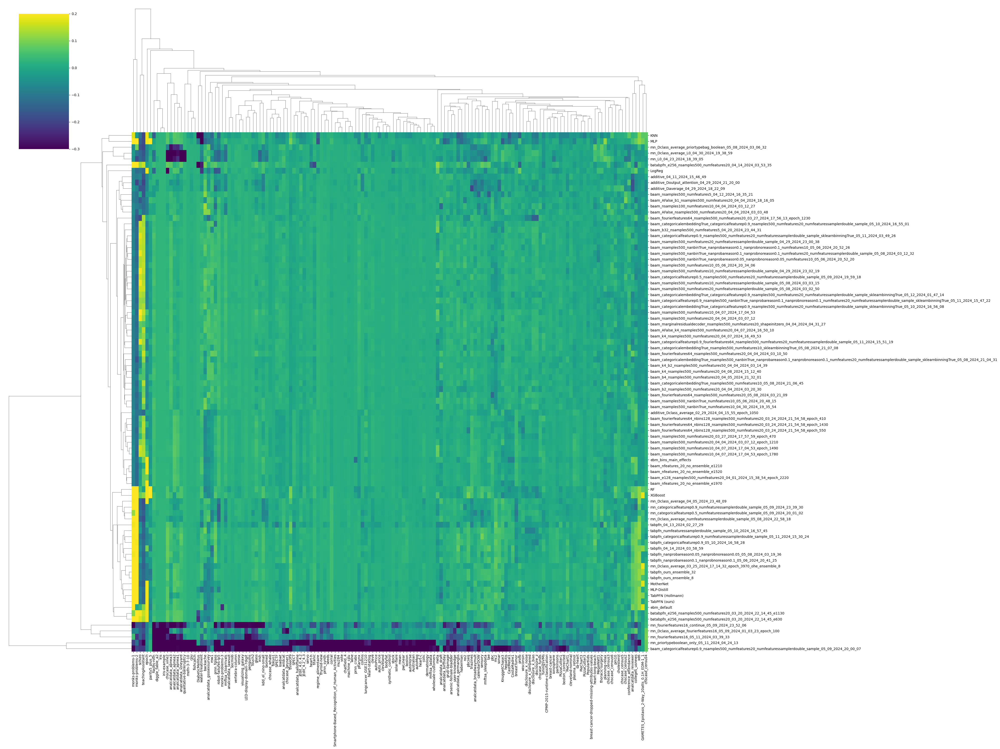

In [594]:
sns.clustermap(combined_scores_normed, figsize=(40, 30), vmin=-0.3, vmax=0.2, cmap="viridis")

/anaconda/envs/tabpfn_testing_environment/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning:

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.

/anaconda/envs/tabpfn_testing_environment/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning:

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.



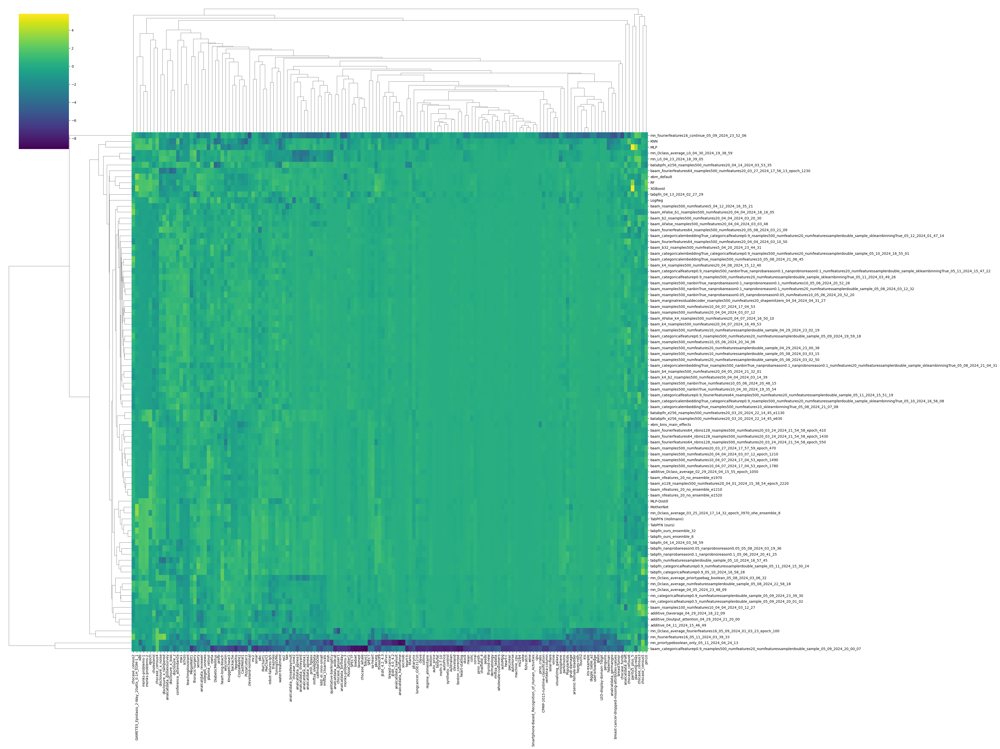

In [595]:
sns.clustermap(combined_scores_normed / combined_scores_normed.std(), figsize=(40, 30), cmap="viridis")

In [596]:
bam_scores.iloc[bam_scores.index.str.startswith("baam_nsamples500_numfeatures10_04_07_2024_17_04_53")]

,Australian,CPMP-2015-runtime-classification,CastMetal1,CostaMadre1,DiabeticMellitus,GAMETES_Epistasis_2-Way_20atts_0.1H_EDM-1_1,KnuggetChase3,LED-display-domain-7digit,MegaWatt1,PieChart1,...,vinnie,visualizing_galaxy,vote,water-treatment,wholesale-customers,wine,wisconsin,xd6,mean,epoch
baam_nsamples500_numfeatures10_04_07_2024_17_04_53_epoch_1490,0.929341,0.715226,0.750323,0.759163,0.997342,0.492194,0.687081,0.955970,0.663775,0.844036,...,0.930146,0.993904,0.992468,0.971283,0.959680,0.999325,0.613494,0.859699,0.831231,0.120544
baam_nsamples500_numfeatures10_04_07_2024_17_04_53_epoch_1780,0.928440,0.711238,0.743568,0.742995,0.997248,0.494026,0.668737,0.956948,0.638282,0.843087,...,0.930103,0.994559,0.991520,0.967895,0.960120,0.999209,0.635722,0.859741,0.830393,0.144005
baam_nsamples500_numfeatures10_04_07_2024_17_04_53,0.933837,0.722671,0.798467,0.784993,0.996449,0.466260,0.716821,0.954436,0.640841,0.829062,...,0.945166,0.990789,0.994405,0.971429,0.963219,0.998302,0.641938,0.848751,0.831275,0.148859


In [597]:
bam_scores = combined_scores.iloc[combined_scores.index.str.startswith("baam")]

In [598]:
import re

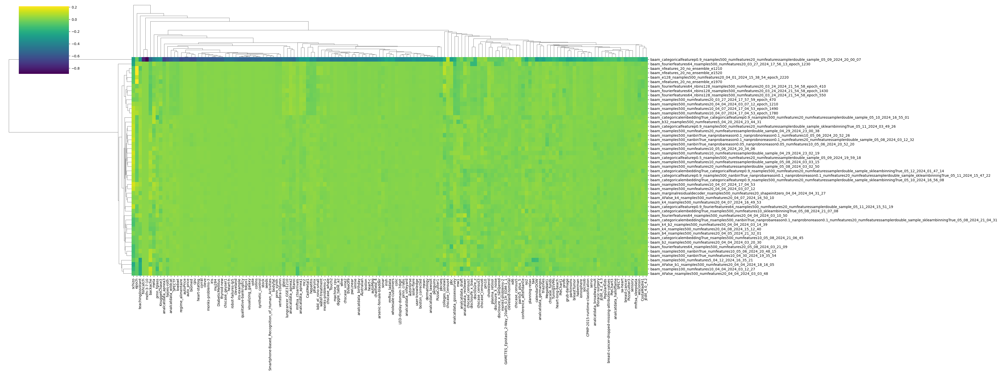

In [599]:
sns.clustermap(bam_scores - bam_scores.mean(), figsize=(40, 15), cmap="viridis")

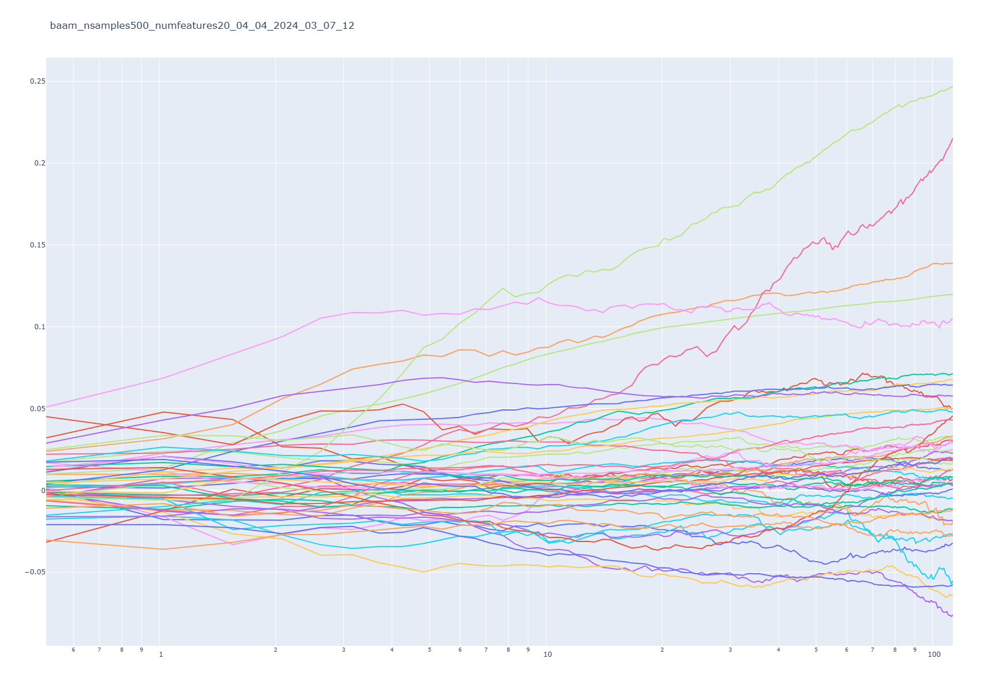

In [470]:
#run = mlflow.get_run("4c84e27984e44f6298d7178842b87ec8") # 10 features
plot_run_validation("baam_nsamples500_numfeatures20_04_04_2024_03_07_12")

In [567]:
plot_run_validation("tabpfn_04_14_2024_03_58_59")

In [568]:
plot_run_validation("tabpfn_04_14_2024_03_58_59", norm=False)

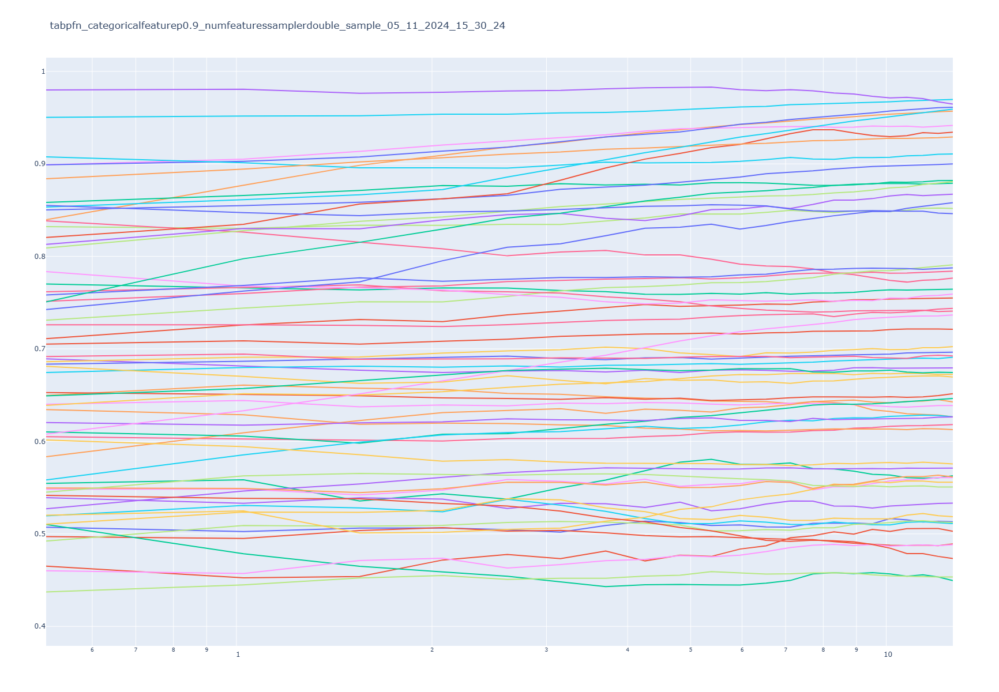

In [569]:
plot_run_validation("tabpfn_categoricalfeaturep0.9_numfeaturessamplerdouble_sample_05_11_2024_15_30_24", norm=False)

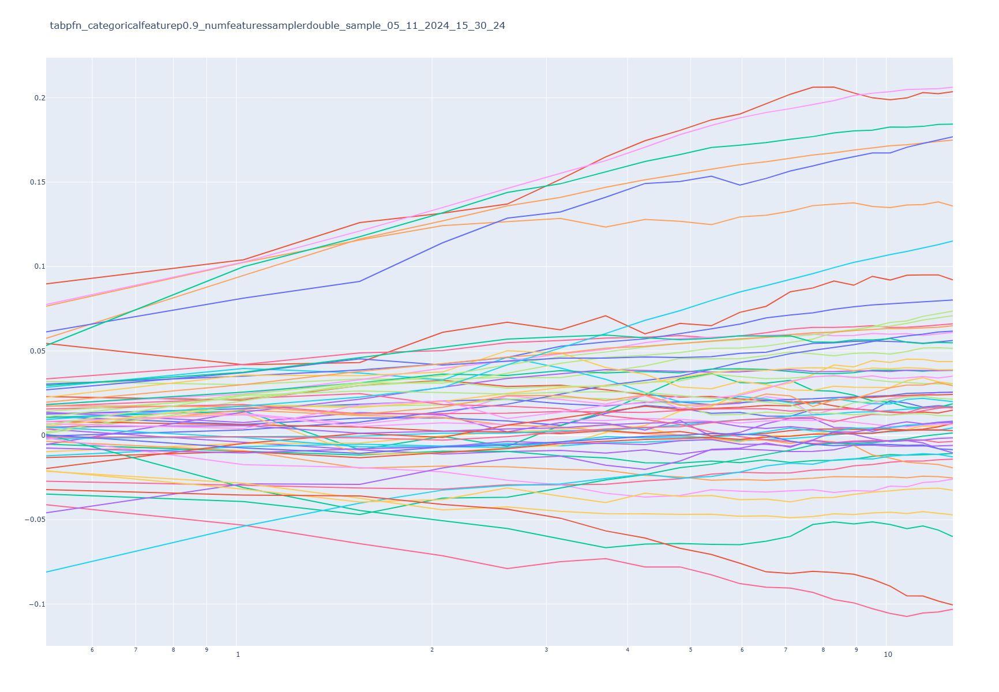

In [570]:
plot_run_validation("tabpfn_categoricalfeaturep0.9_numfeaturessamplerdouble_sample_05_11_2024_15_30_24")

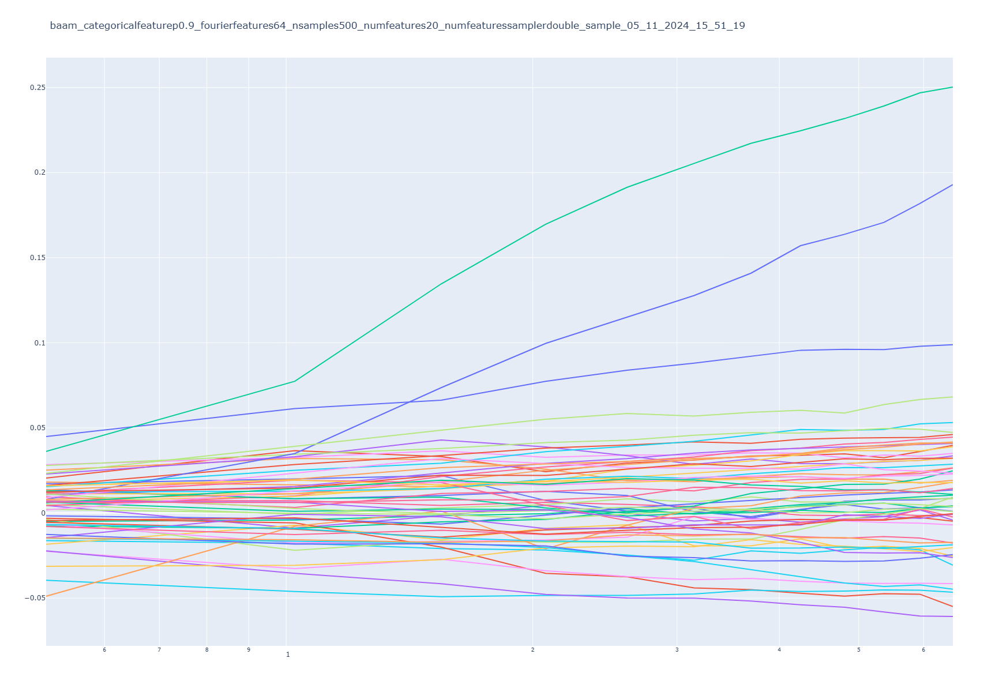

In [571]:
plot_run_validation("baam_categoricalfeaturep0.9_fourierfeatures64_nsamples500_numfeatures20_numfeaturessamplerdouble_sample_05_11_2024_15_51_19")

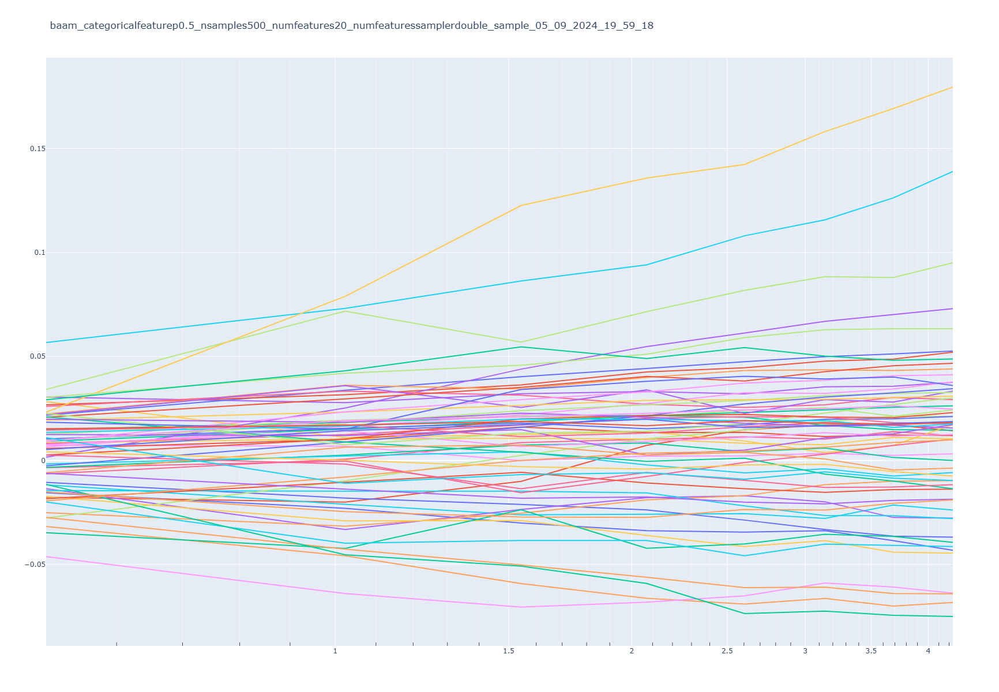

In [306]:
plot_run_validation("baam_categoricalfeaturep0.5_nsamples500_numfeatures20_numfeaturessamplerdouble_sample_05_09_2024_19_59_18")

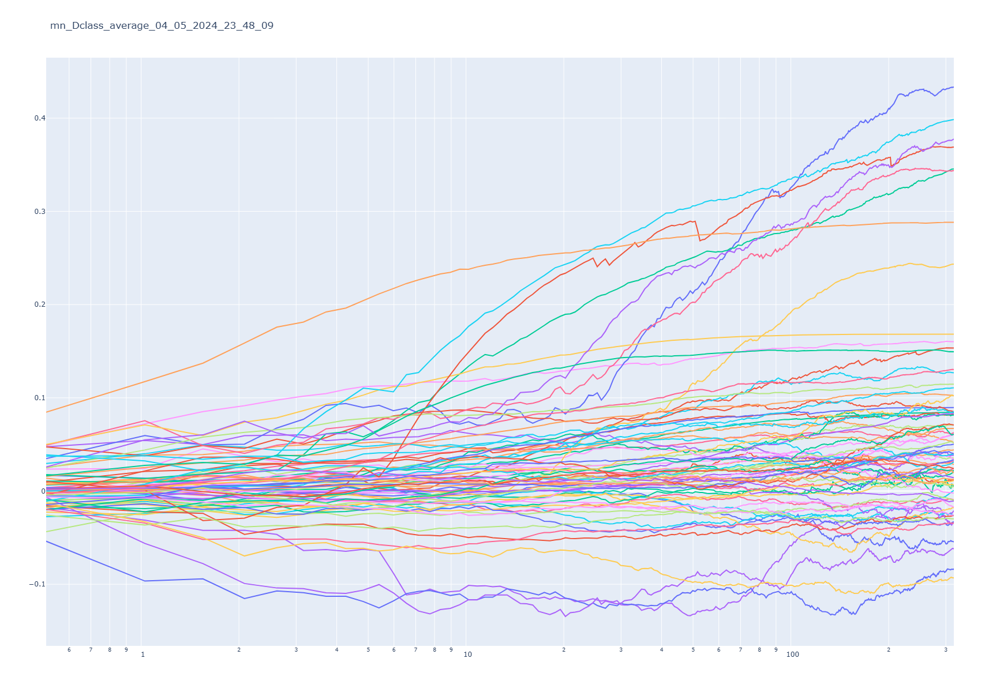

In [79]:
plot_run_validation("mn_Dclass_average_04_05_2024_23_48_09")

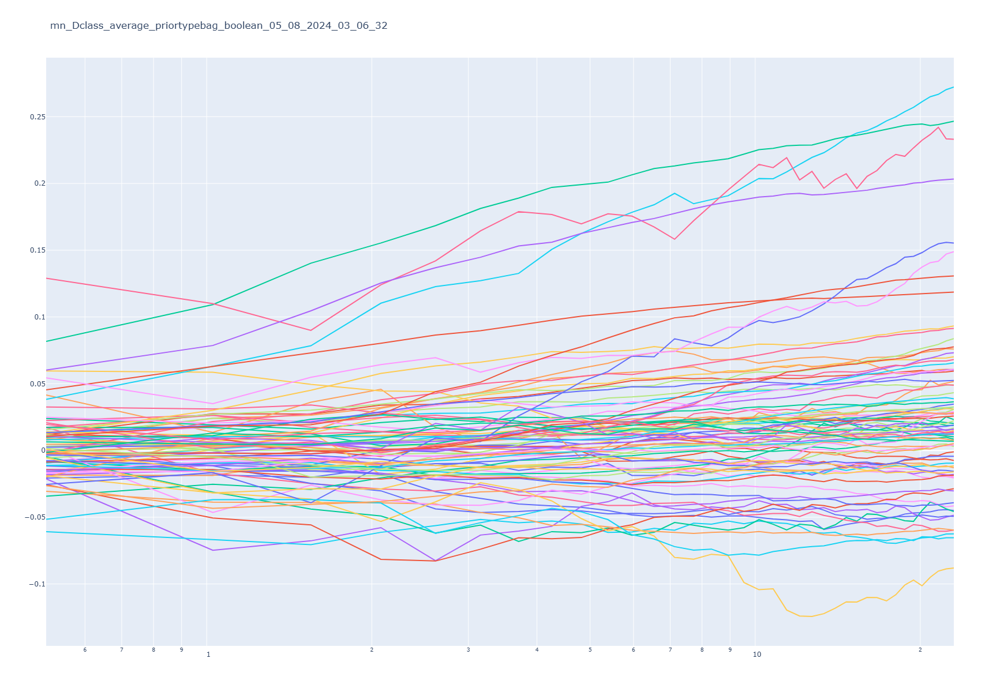

In [305]:
plot_run_validation("mn_Dclass_average_priortypebag_boolean_05_08_2024_03_06_32")

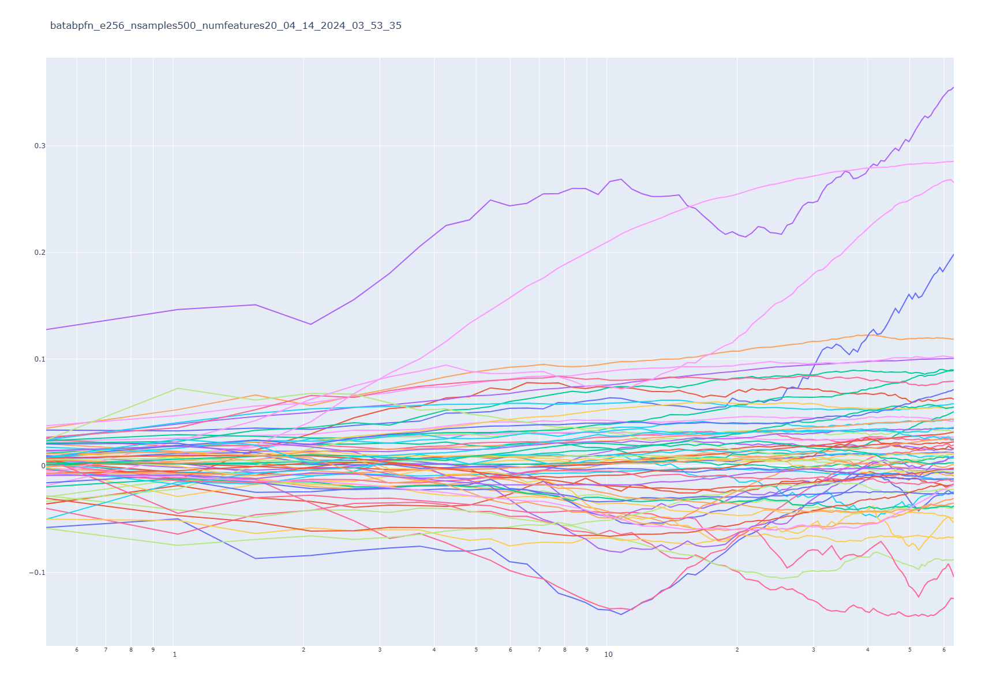

Bad pipe message: %s [b'\\X\x1d\xd2\xd1U\x92\x083c\xd2e\x00\xad\xa2/6\x19 \xbf\xe1\x97\xb7\x99\xfe!3\xe7o\x8b\xb4\t~R\x02\xfd\xfd2\x83\x9d\xaa\xec\xcf\x902\xae\xcb\xc4\x17]A\x00\x08\x13\x02\x13\x03\x13\x01\x00\xff\x01\x00\x00\x8f\x00\x00\x00\x0e\x00\x0c\x00\x00\t127.0.0.1\x00\x0b\x00\x04\x03\x00\x01\x02\x00\n\x00\x0c\x00\n\x00\x1d\x00\x17\x00\x1e\x00\x19\x00\x18\x00#\x00\x00\x00\x16\x00\x00\x00\x17\x00\x00\x00\r\x00\x1e\x00\x1c\x04\x03\x05\x03\x06\x03\x08\x07\x08\x08\x08\t\x08\n\x08\x0b\x08\x04\x08\x05\x08\x06\x04']
Bad pipe message: %s [b'', b'']
Bad pipe message: %s [b'']
Bad pipe message: %s [b'\x03\x02\x03\x04\x00-\x00\x02\x01\x01\x003\x00&\x00$\x00\x1d\x00 \xee\xbf\xff#\xa4\xf9\xe0\x0e\x8e02\xb2\xc1\xb7\xdf\x82\xa8-\t\x1b[\t']
Bad pipe message: %s [b"\xef/\xfe\xf4\xd3\x88U*\xe2*\x13\xaf\x90\xb5a\x88\ty\x00\x00|\xc0,\xc00\x00\xa3\x00\x9f\xcc\xa9\xcc\xa8\xcc\xaa\xc0\xaf\xc0\xad\xc0\xa3\xc0\x9f\xc0]\xc0a\xc0W\xc0S\xc0+\xc0/\x00\xa2\x00\x9e\xc0\xae\xc0\xac\xc0\xa2\xc0\x9e\xc0\\\xc0`\x

In [78]:
plot_run_validation("batabpfn_e256_nsamples500_numfeatures20_04_14_2024_03_53_35")

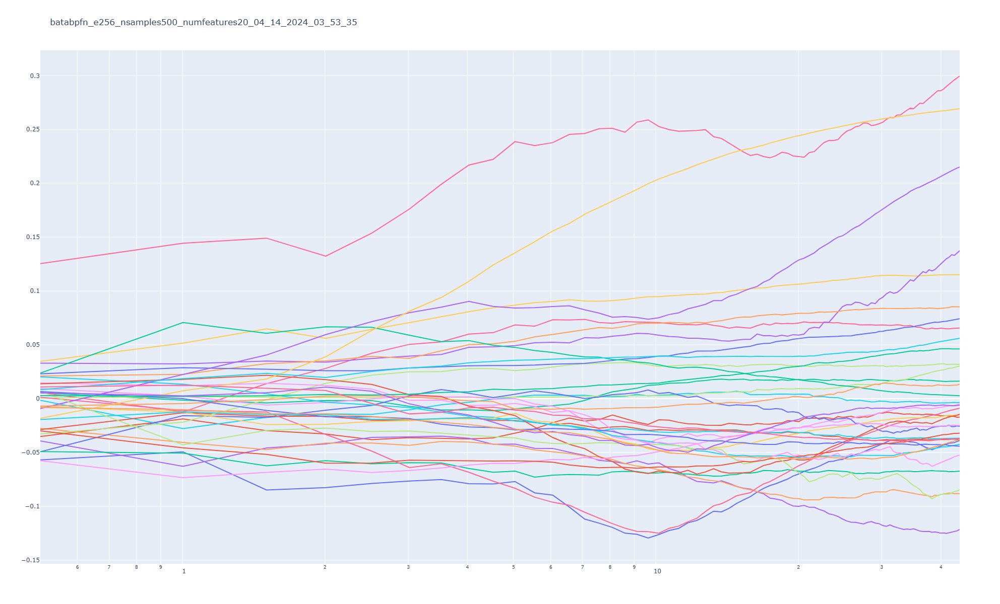

In [74]:
plot_run_validation("batabpfn_e256_nsamples500_numfeatures20_04_14_2024_03_53_35", min_std=0.02)

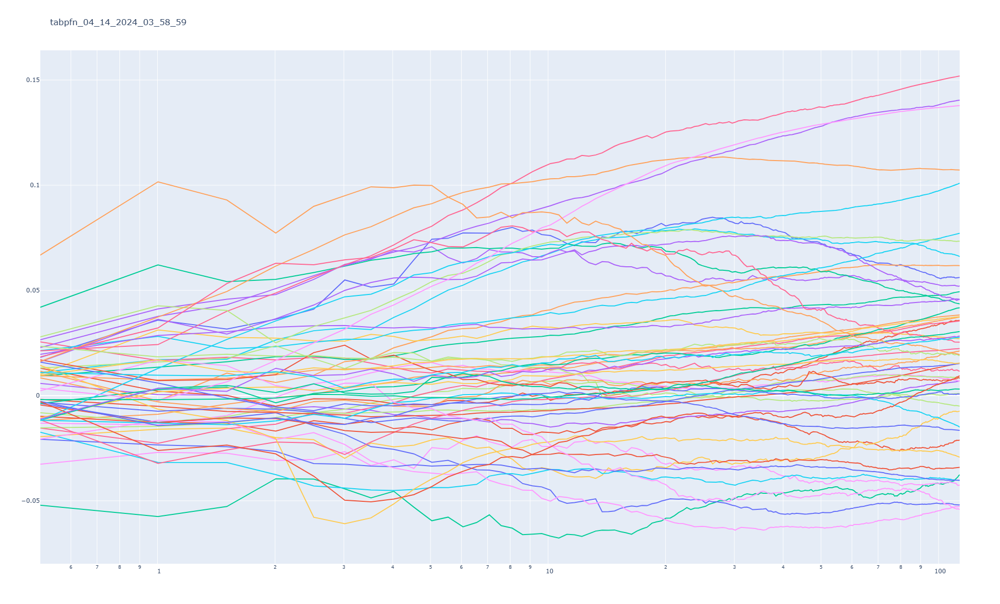

In [66]:
plot_run_validation("tabpfn_04_14_2024_03_58_59")

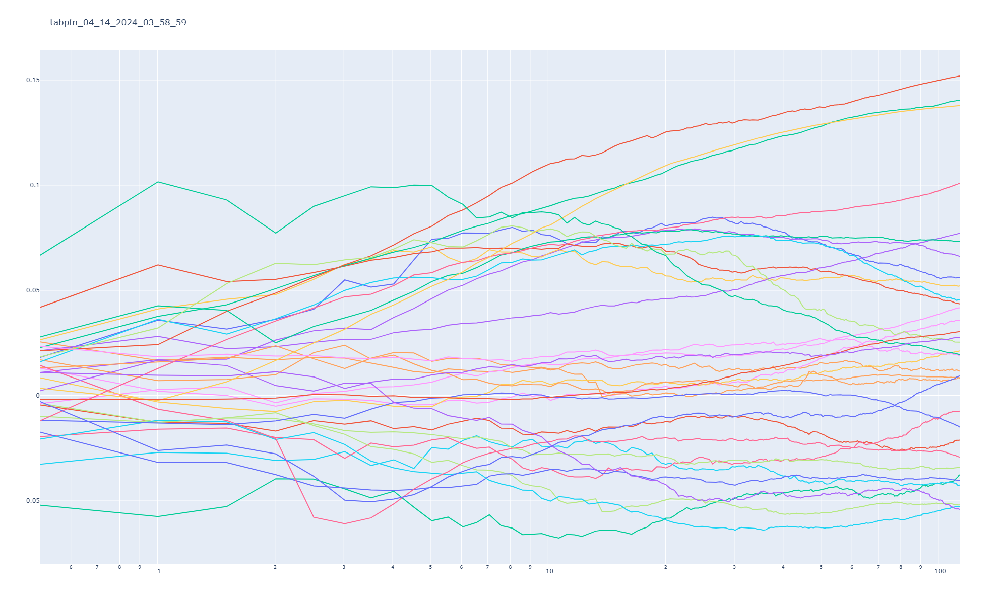

In [67]:
plot_run_validation("tabpfn_04_14_2024_03_58_59", min_std=0.015)


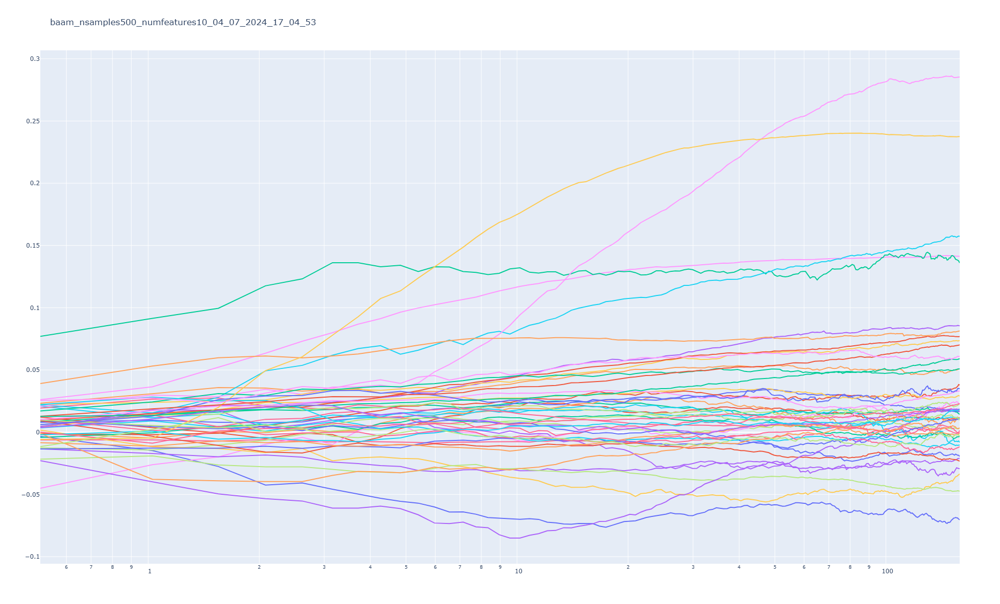

In [84]:
plot_run_validation("baam_nsamples500_numfeatures10_04_07_2024_17_04_53")

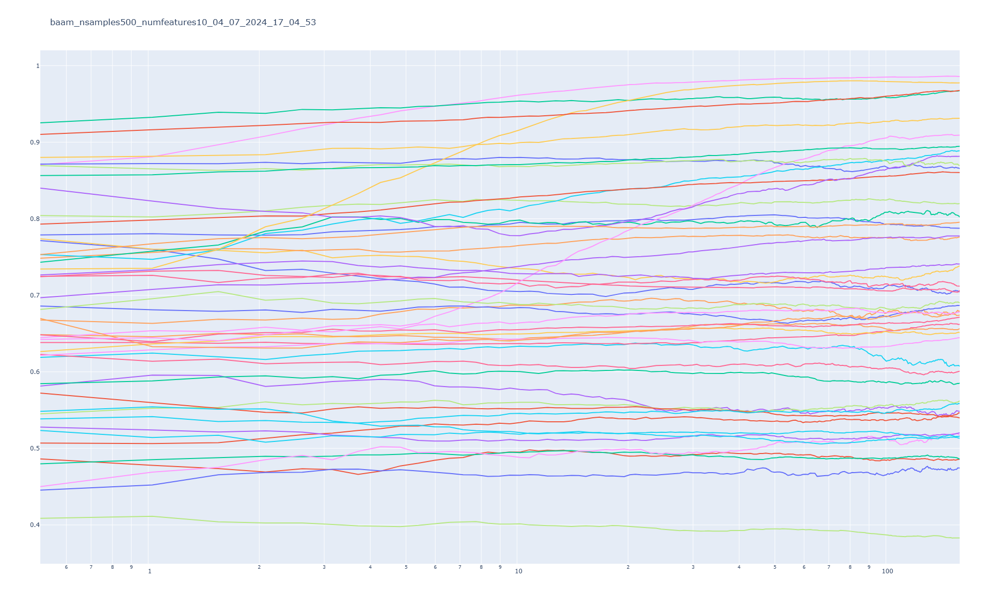

In [85]:
plot_run_validation("baam_nsamples500_numfeatures10_04_07_2024_17_04_53", norm=False)

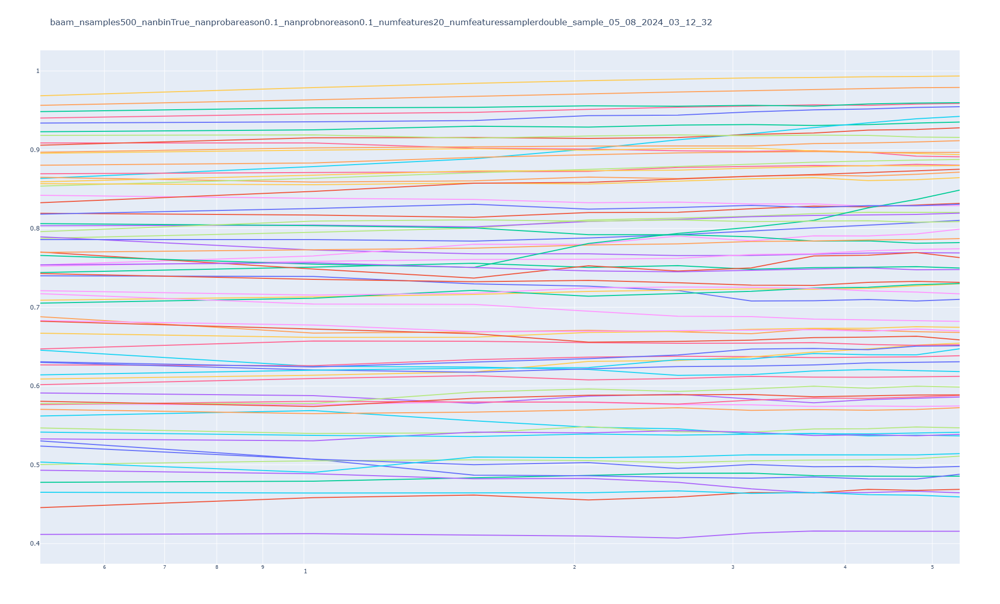

In [86]:
plot_run_validation("baam_nsamples500_nanbinTrue_nanprobareason0.1_nanprobnoreason0.1_numfeatures20_numfeaturessamplerdouble_sample_05_08_2024_03_12_32", norm=False)

In [91]:
import random
bla = [max(round(random.gammavariate(1, 10)), 2) for x in range(10000)]

(array([2.873e+03, 6.990e+02, 6.560e+02, 5.820e+02, 4.800e+02, 4.480e+02,
        4.030e+02, 3.560e+02, 3.360e+02, 2.770e+02, 2.610e+02, 2.350e+02,
        2.380e+02, 2.300e+02, 1.910e+02, 1.580e+02, 1.410e+02, 1.400e+02,
        1.400e+02, 1.120e+02, 1.130e+02, 9.500e+01, 8.500e+01, 7.100e+01,
        7.000e+01, 6.100e+01, 5.100e+01, 5.500e+01, 4.300e+01, 3.800e+01,
        3.600e+01, 3.200e+01, 3.100e+01, 3.700e+01, 1.800e+01, 2.500e+01,
        2.200e+01, 2.100e+01, 1.400e+01, 1.500e+01, 1.100e+01, 8.000e+00,
        7.000e+00, 9.000e+00, 6.000e+00, 2.000e+00, 6.000e+00, 1.000e+01,
        5.000e+00, 4.000e+00, 5.000e+00, 2.000e+00, 6.000e+00, 3.000e+00,
        6.000e+00, 1.000e+00, 2.000e+00, 0.000e+00, 1.000e+00, 1.000e+00,
        3.000e+00, 3.000e+00, 0.000e+00, 1.000e+00, 1.000e+00, 0.000e+00,
        0.000e+00, 1.000e+00, 1.000e+00, 3.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 1.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 1.000e+00, 0.000e+0

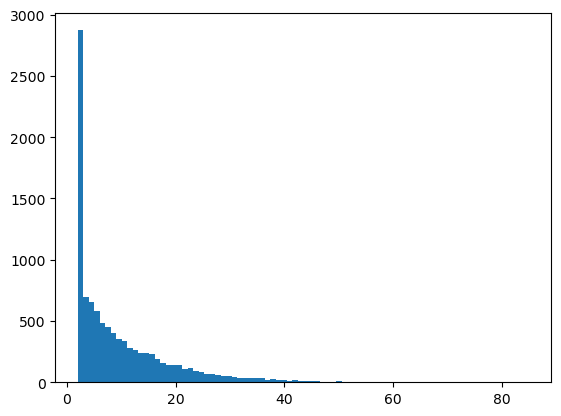

In [94]:
import numpy as np
import matplotlib.pyplot as plt
plt.hist(np.array(bla), bins="auto")

In [95]:
np.bincount(np.array(bla))

array([   0,    0, 2170,  703,  699,  656,  582,  480,  448,  403,  356,
        336,  277,  261,  235,  238,  230,  191,  158,  141,  140,  140,
        112,  113,   95,   85,   71,   70,   61,   51,   55,   43,   38,
         36,   32,   31,   37,   18,   25,   22,   21,   14,   15,   11,
          8,    7,    9,    6,    2,    6,   10,    5,    4,    5,    2,
          6,    3,    6,    1,    2,    0,    1,    1,    3,    3,    0,
          1,    1,    0,    0,    1,    1,    3,    0,    0,    0,    1,
          0,    0,    0,    0,    0,    1,    0,    0,    1])